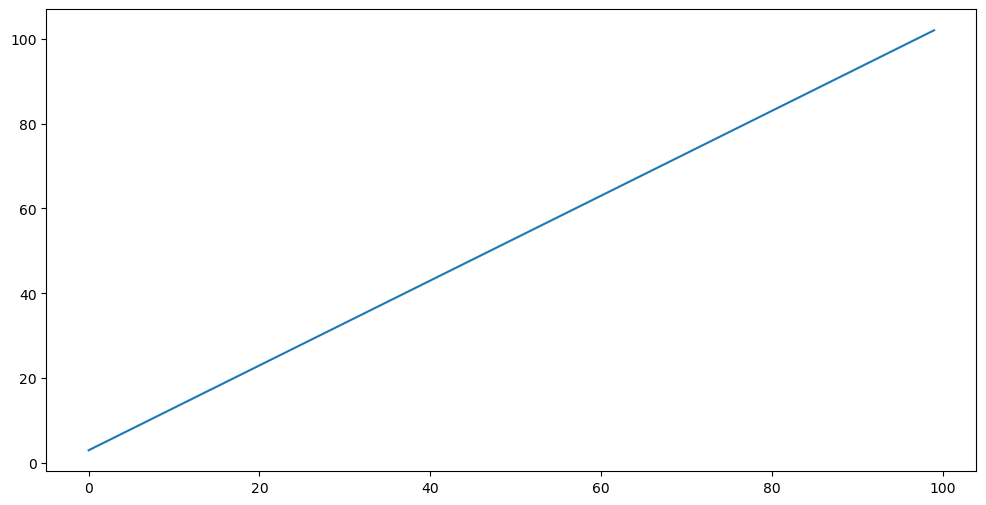

array([  3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,
        16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,
        29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,
        68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
        94,  95,  96,  97,  98,  99, 100, 101, 102])

In [1]:
##lineAndRandomPoints
import numpy as np
import matplotlib.pyplot as plt

line = np.array([i + 3 for i in range(100)])
figure = plt.figure(figsize = (12,6))
plt.plot(line)
plt.show()
line

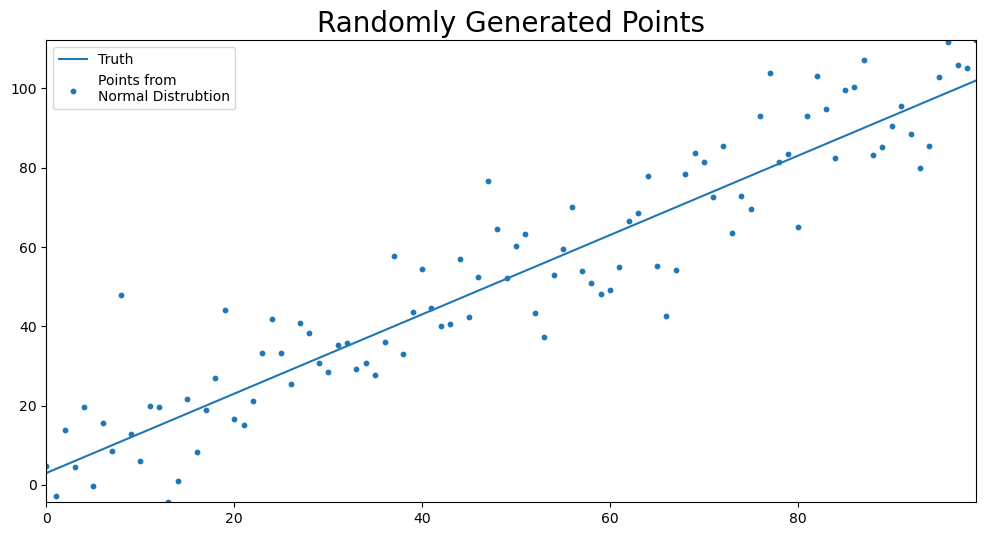

In [2]:
import random

points = []
for point in line:
    points.append(random.normalvariate(point, 10))

figure = plt.figure(figsize = (12, 6))
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.plot(line, label ="Truth")
plt.scatter(np.arange(len(points)), points, s = 10,
           label = "Points from\nNormal Distrubtion")
plt.title("Randomly Generated Points", fontsize = 20)
plt.legend(loc = "best")
plt.show()

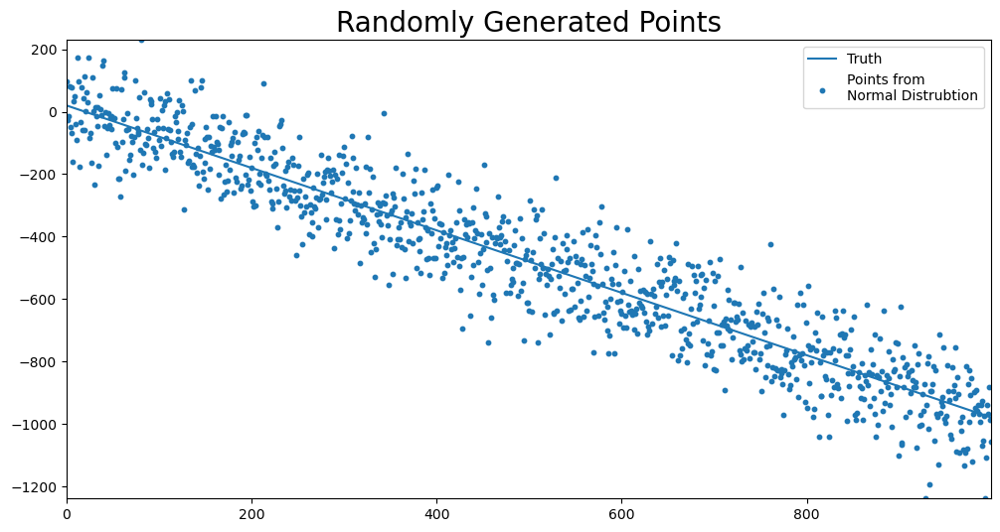

In [3]:
import random

def build_random_data_with_line(y_int, slope, SD = 1, line_length = 100):
    line = np.array([slope * i + y_int for i in range(line_length)])    
    points = []
    for point in line:
        points.append(random.normalvariate(point, SD))
        
    return line, points

def plot_line(line, points, line_name = "Truth",
              title = "Randomly Generated Points"):

    figure = plt.figure(figsize = (12, 6))
    plt.rcParams["axes.xmargin"] = 0
    plt.rcParams["axes.ymargin"] = 0
    plt.plot(line, label =line_name)
    plt.scatter(np.arange(len(points)), points, s = 10,
               label = "Points from\nNormal Distrubtion")
    plt.title("Randomly Generated Points", fontsize = 20)
    plt.legend(loc = "best")
    plt.show()
    
line, points = build_random_data_with_line(y_int = 20, slope = -1, SD = 100, line_length = 1000)
plot_line(line, points)

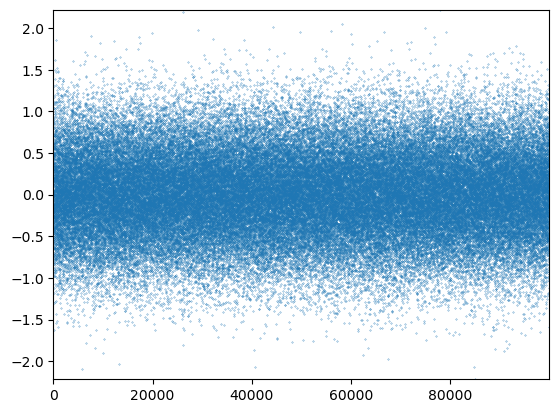

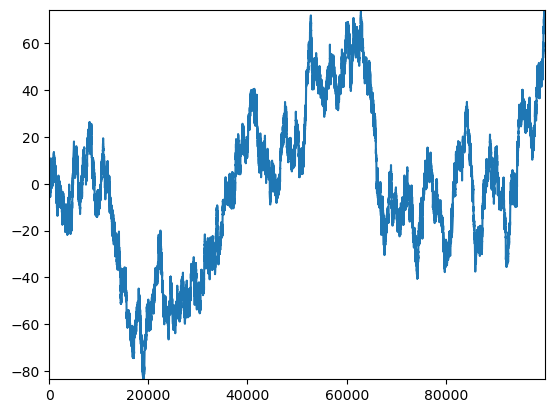

In [4]:
#montecarloSimulation

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random


mu = 0
#SD is sigma, variance is sigma**2
sigma = .5
random_list = []
observations = 100000
for i in range(100000):
    random_list.append(random.normalvariate(mu, sigma))

plt.plot(random_list, ls = "",linewidth = 1, marker =".", markersize = .5)
plt.show()
plt.close()

simulation = [] 

for i in range(len(random_list)):
    val = random_list[i]
    if i == 0:
        simulation.append(val)
    else:
        simulation.append(simulation[i-1] + val)
        
plt.plot(simulation)
plt.show()
plt.close()



In [5]:
def run_monte_carlo(mean, sigma, num_sims, sim_dict, index):
    
    for i in range(num_sims):
        sim_dict[i] = {}
        for ix in index:
            sim_dict[i][ix] = random.normalvariate(mean, sigma)


In [6]:
mean = 0
sigma = 1
monte_carlo_sim_dict = {}
num_sims = 2000
index = np.arange(2000)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)
        
monte_carlo_sim_df = (pd.DataFrame(monte_carlo_sim_dict))
        
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-1.481151,-1.297390,-0.200880,-0.522637,2.062862,-0.167184,0.277504,-0.835943,1.996509,-0.905276,...,1.684600,-1.610542,0.685790,1.373262,0.175227,-0.162317,0.953140,0.580441,1.437725,2.433538
1,0.158879,-2.286865,-0.747473,0.517072,-0.006781,0.117472,-0.362146,0.326888,1.358276,-1.592665,...,1.691004,0.048009,-1.075810,-1.454149,0.810083,0.401592,2.806239,-0.997214,0.062510,-0.829677
2,0.426643,0.211987,-1.927455,-0.023009,-1.105268,0.764581,-0.845002,-1.352900,0.432876,0.833509,...,1.400394,0.975670,-0.991885,1.516881,1.480291,1.271085,-0.079160,0.251915,-0.729849,-1.325215
3,0.152144,-0.188549,2.055122,0.013410,0.445848,-0.235012,1.266777,-0.049884,-0.019867,0.648714,...,-0.258928,-1.265686,0.915848,1.496100,0.491575,1.660241,1.823778,-0.091932,-0.763449,-1.144141
4,-1.195966,0.133158,-0.736784,1.932611,-0.191862,-2.452748,0.695250,-1.768622,-0.549758,-0.088692,...,1.617317,-1.659991,0.387579,0.900986,1.149613,-0.822750,-0.308995,0.035106,-0.597530,-0.743594
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,0.697280,-1.273454,0.051348,0.325750,-0.891297,0.637435,0.451650,-0.773503,-0.601731,0.591832,...,1.578891,2.227604,0.082777,-1.575392,0.524859,1.216238,-1.022842,-0.499963,0.497344,-0.614669
1996,0.523256,-0.397353,0.089841,-0.455994,-2.074148,-1.695777,1.343653,-0.116185,1.824836,1.153181,...,-0.791939,0.084958,-0.787231,-0.126535,0.086445,0.497670,0.217858,-2.849100,0.330453,-0.265613
1997,-1.006680,1.028043,-2.445356,-0.490279,-0.037815,-0.363364,-1.377440,0.216112,-0.770653,-0.130705,...,0.880349,0.763984,0.190649,-0.291754,-1.766133,0.656753,0.463919,1.165719,-1.401749,-0.924032
1998,0.242501,-0.928591,0.261631,-0.652295,0.619029,-0.197589,0.312895,-0.158003,-1.078699,0.135277,...,1.281268,0.074821,1.010058,0.356621,-0.508871,2.414181,2.402308,0.156095,0.235075,0.143162


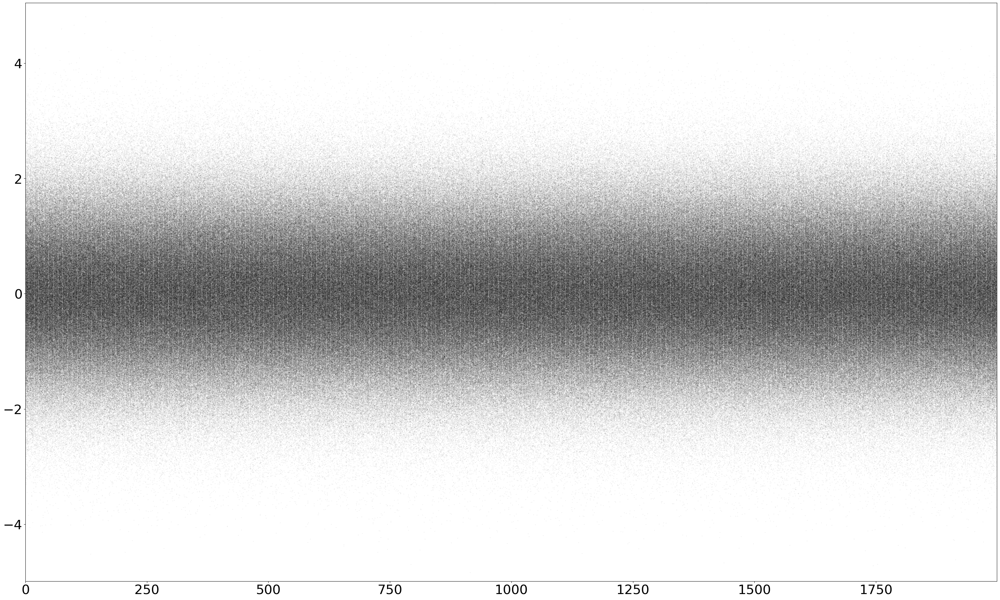

In [7]:
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.rcParams["font.size"] = 30

fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.plot.line(legend = False, ls = " ", marker=".", markersize = .2, 
                            color ="k", alpha = .5, ax = ax)

plt.show()

C:\Users\JLCat\AppData\Local\Temp\ipykernel_27196\667913757.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])


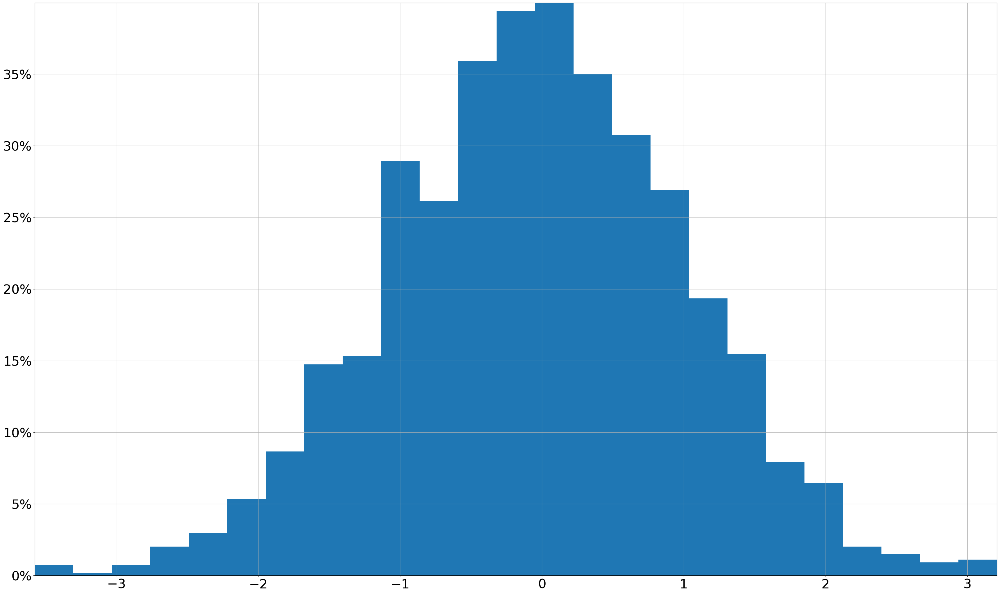

In [8]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.iloc[-1].hist(bins = 25, density = True,
                                ax = ax)

# set vertical axis values as percent
y_vals = ax.get_yticks()
ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])
plt.show()
plt.close()

## Monte Carlo with a Positive Trend

In [9]:
mean = .05
sigma = .5
monte_carlo_sim_dict = {}
num_sims = 2000
periods = 2000
index = np.arange(periods)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)

monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).cumsum()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,0.113469,-0.331774,-0.774179,-0.528339,0.466112,-0.305624,-0.605048,0.205230,0.207857,0.917225,...,0.292454,0.441644,0.325706,-0.032121,-0.111668,-0.031351,-0.006445,0.420088,0.029539,-0.123523
1,0.186509,0.235173,-0.760242,-1.118829,0.586771,-0.358946,-0.994037,-0.143181,0.351527,0.955727,...,0.831961,0.073695,1.212427,-0.056793,-0.076967,-0.082778,0.075106,1.187174,0.466952,0.866629
2,-0.560754,0.251851,-0.614431,-0.545573,0.515702,-0.184325,-1.037441,0.160361,0.299911,1.751897,...,1.038325,-0.036446,2.277674,-0.078085,-0.855595,-0.015439,0.599389,1.643956,0.505027,2.077588
3,-0.755348,-0.744361,-0.090059,-0.293497,0.737191,-0.026148,-0.470825,0.388295,0.596969,1.493442,...,1.441339,-1.083372,2.642667,0.294643,0.085980,-0.473193,0.087520,1.121787,-0.473272,2.528071
4,-0.337231,-0.244895,-0.644671,-0.265663,1.411112,-0.533909,-1.196095,0.940974,1.494440,1.873607,...,0.975965,-1.351046,3.656829,0.001389,-0.484585,0.037218,0.088720,0.962089,-0.135936,2.925978
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,80.400337,144.421384,123.112305,129.888500,78.132507,78.240260,64.559078,137.465432,113.746370,59.670773,...,116.636012,107.218123,122.483974,95.627681,95.388262,147.995366,74.208371,111.830524,126.425834,106.400078
1996,79.882538,144.758768,122.288889,129.990597,77.991461,78.070635,65.241700,138.111419,113.432996,59.959792,...,116.924310,106.892320,121.367968,95.329079,94.752051,148.207774,74.789384,111.566245,125.818567,106.350736
1997,80.520678,145.246397,122.799605,129.751387,78.722602,77.119528,65.570848,137.895785,113.851338,60.039827,...,117.101294,107.097447,120.940111,95.879217,94.843031,147.997846,75.397895,110.954335,126.241643,106.947887
1998,79.734277,145.529623,123.447992,129.455515,78.862075,76.854290,65.433657,137.245657,114.087477,60.140077,...,117.639132,106.773958,120.736017,95.860159,94.722807,148.685766,76.426109,111.411380,126.120526,106.874323


In [10]:
def plot_monte_carlo_sim(sim_data,  title = None, logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop("mean", inplace = False, axis = 1).plot.line(
            legend=False, ls = "", marker =".", markersize = .2, color = "k", 
        alpha = .05, logy = logy, ax = ax)
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

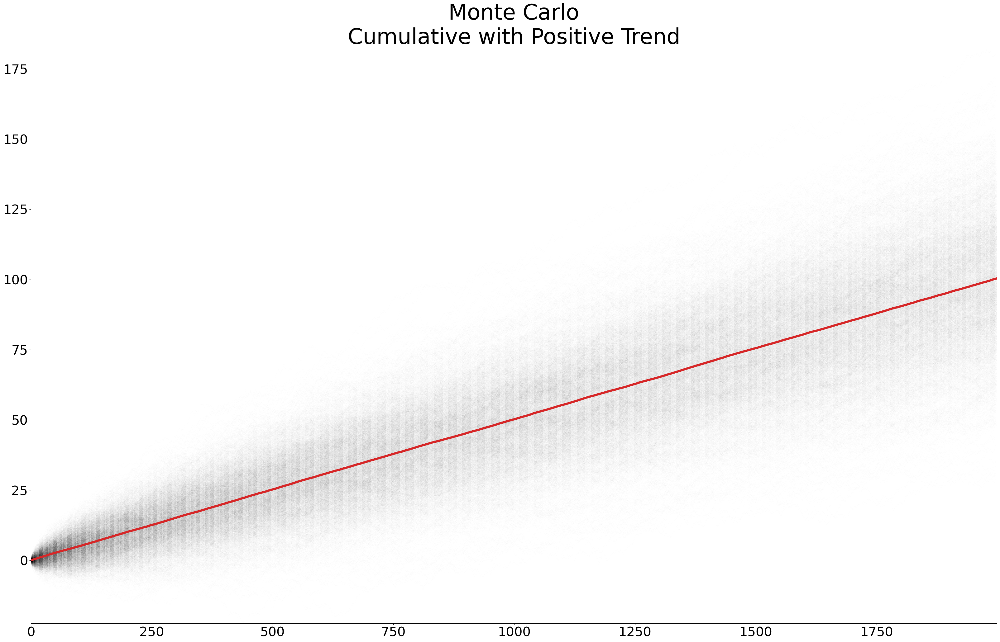

In [11]:
plot_monte_carlo_sim(monte_carlo_sim_df,  
    title = "Monte Carlo\nCumulative with Positive Trend", logy = False)


### Calculating Expected Value

In [12]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis = 1)
monte_carlo_sim_df["mean"]

0         0.051479
1         0.114115
2         0.157003
3         0.225712
4         0.279255
           ...    
1995    100.173627
1996    100.238232
1997    100.296391
1998    100.338166
1999    100.411001
Name: mean, Length: 2000, dtype: float64

### Simulating Changes in Portfolio Values

In [13]:
import pandas_datareader.data as web
import datetime
import yfinance  as yf
yf.pdr_override()

start = datetime.datetime(2005, 1, 1)
end = datetime.datetime.today()

data_dict = {}
stocks = "MSFT", "AAPL", "IBM", "GOOG"
for name in stocks:
    data_dict[name] =web.get_data_yahoo(name, start, end)

# make a list of the close data for each stock
close_data_dict = {key:val["Close"] for key, val in data_dict.items()}
close_data_df = pd.DataFrame(close_data_dict)

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


In [14]:
close_data_pct_change = close_data_df.pct_change()
close_data_pct_change

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,NaN,NaN,NaN,NaN
2005-01-04,0.003740,0.010270,-0.010742,-0.040501
2005-01-05,-0.002235,0.008758,-0.002068,-0.005090
2005-01-06,-0.001120,0.000775,-0.003109,-0.025632
2005-01-07,-0.002991,0.072811,-0.004366,0.028109
...,...,...,...,...
2024-04-11,0.011033,0.043271,-0.000753,0.019853
2024-04-12,-0.014091,0.008627,-0.019527,-0.009951
2024-04-15,-0.019578,-0.021863,-0.005596,-0.017966


In [15]:
close_data_normalized = close_data_pct_change.add(1).cumprod()
close_data_normalized.fillna(1, inplace =True)
close_data_normalized

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499
2005-01-05,1.001496,1.019118,0.987212,0.954615
2005-01-06,1.000374,1.019908,0.984143,0.930146
2005-01-07,0.997382,1.094169,0.979847,0.956292
...,...,...,...,...
2024-04-11,16.003366,154.878109,1.989273,31.847005
2024-04-12,15.777861,156.214189,1.950429,31.530101
2024-04-15,15.468961,152.798800,1.939514,30.963633


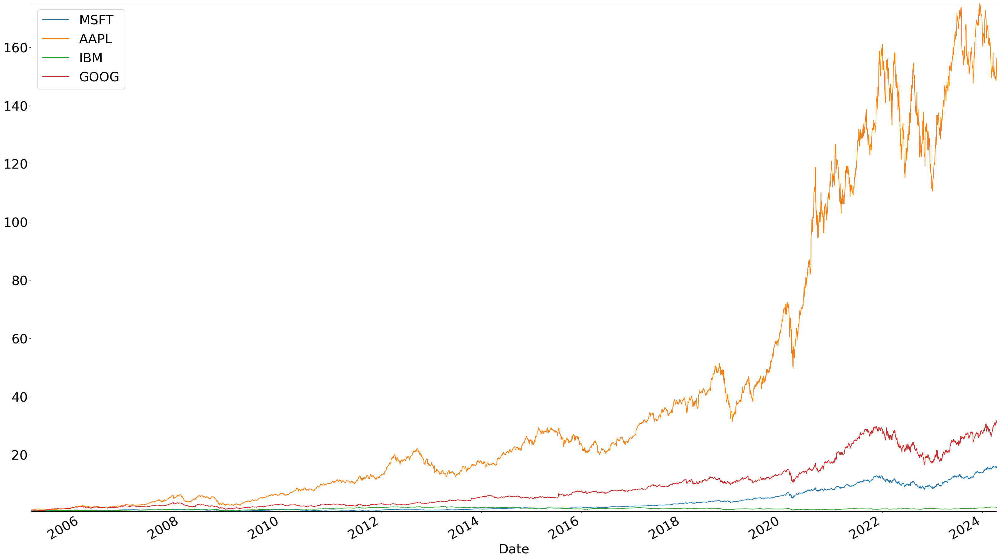

In [16]:
fig, ax = plt.subplots(figsize=(40,24))
close_data_normalized.plot.line(ax = ax)
plt.show()
plt.close()

### Daily Rate of Return

Derive the daily rate of return from the present value equation.

>$PV = \frac{FV}{(1 + r)^t}$
>
>Overall rate of return: $R=\frac{FV}{PV}$

Discount the overall rate of return to find the average rate of return. We will use this to define the mean of the standard normal distribution:

>$ r = (R)^{\frac{1}{t}} - 1$
>
>$t$ is measured in days

In [17]:
mean_var_df = pd.DataFrame(
    {"mean": close_data_normalized.iloc[-1].div(close_data_normalized.iloc[0]) ** (
        1 / close_data_normalized["MSFT"].count()) - 1, 
                            "sigma" : close_data_pct_change.std()})
mean_var_df

,mean,sigma
MSFT,0.000563,0.017239
AAPL,0.001031,0.020436
IBM,0.000139,0.014440
GOOG,0.000708,0.018954


In [18]:
num_sims = 500
dates = list(close_data_df.index)
monte_carlo_sim_dict = {}
for stock in stocks:
    monte_carlo_sim_dict[stock] = {}
    mean = mean_var_df["mean"][stock]
    sigma = mean_var_df["sigma"][stock]   
    run_monte_carlo(mean, 
                    sigma, 
                    num_sims, 
                    monte_carlo_sim_dict[stock], 
                    dates)
#    monte_carlo_sim_dict[stock] = pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod()
monte_carlo_sim_dfs = {stock: pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod() for stock in stocks}

In [19]:
monte_carlo_sim_dfs

{'MSFT':                  0         1         2         3          4         5    \
 2005-01-03  0.989445  0.976642  0.990790  0.992848   0.997568  1.013667   
 2005-01-04  1.026444  0.966059  0.999355  0.990313   1.019559  1.023739   
 2005-01-05  1.031302  0.979521  0.999623  0.977038   0.997370  1.017634   
 2005-01-06  1.012079  1.011423  0.995275  0.995616   0.993300  1.016205   
 2005-01-07  1.029114  1.013691  1.019557  1.020762   1.017415  1.026972   
 ...              ...       ...       ...       ...        ...       ...   
 2024-04-11  4.421361  0.768906  3.544570  9.007310  45.132574  1.369630   
 2024-04-12  4.512049  0.775903  3.529987  9.219225  45.147089  1.399418   
 2024-04-15  4.536830  0.762227  3.528067  9.446995  47.386509  1.388031   
 2024-04-16  4.542215  0.790413  3.529453  9.328651  46.784140  1.411435   
 2024-04-17  4.552908  0.800350  3.584861  9.515840  46.601960  1.417502   
 
                  6          7         8         9    ...       490       491 

In [20]:
def plot_monte_carlo_sim(sim_data, 
                         observed_data = None, 
                         title = None, 
                         logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)    
    index = sim_data.index
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop(["mean"], inplace = False, axis = 1).plot.line(
            legend=False, marker =".",
        markersize = .1, 
        color = "k", 
        alpha = .05, 
        logy = logy, 
        ax = ax)
    if observed_data is not None:
        observed_data.plot.line(legend = False, 
                                color = "C2", 
                                linewidth = 5, 
                                logy = logy, 
                                ax = ax)
    
        # find x coordinate of lowest value observed
        obs_text_x = observed_data[observed_data == observed_data.min()].index
        plt.text(obs_text_x, observed_data.loc[obs_text_x] * .7,
                 "Observed", fontsize = 70, color = "C2")
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    plt.text(index[-400], sim_data["mean"].iloc[-400] * 1.5, "Exp\nVal",
            fontsize = 70, color = "C3")
   
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

In [21]:
monte_carlo_sim_dfs[stock].median(axis = 1)

2005-01-03     1.000023
2005-01-04     1.001316
2005-01-05     1.001086
2005-01-06     1.000161
2005-01-07     1.001792
                ...    
2024-04-11    11.866779
2024-04-12    12.013582
2024-04-15    11.926505
2024-04-16    12.105395
2024-04-17    12.021906
Length: 4855, dtype: float64

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

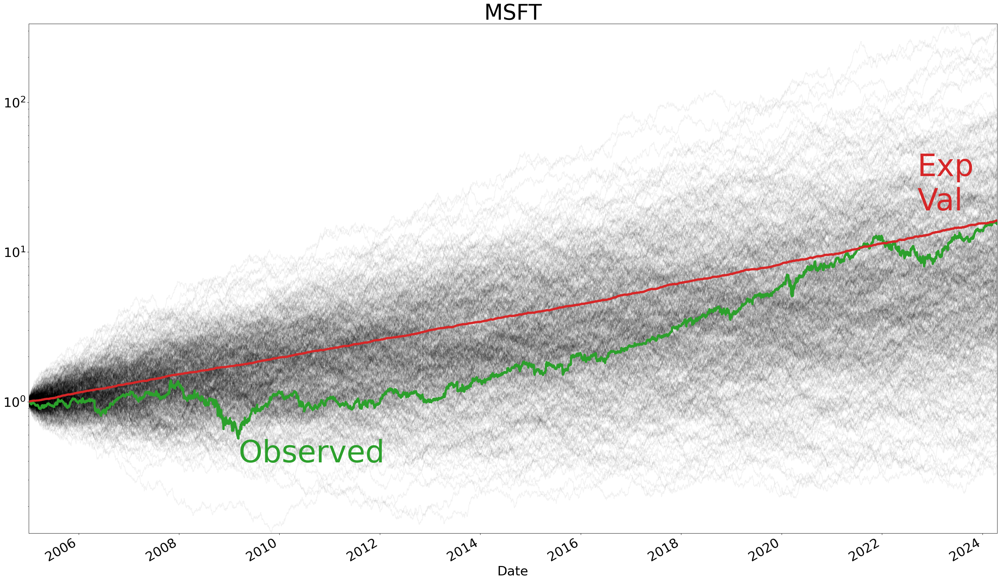

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

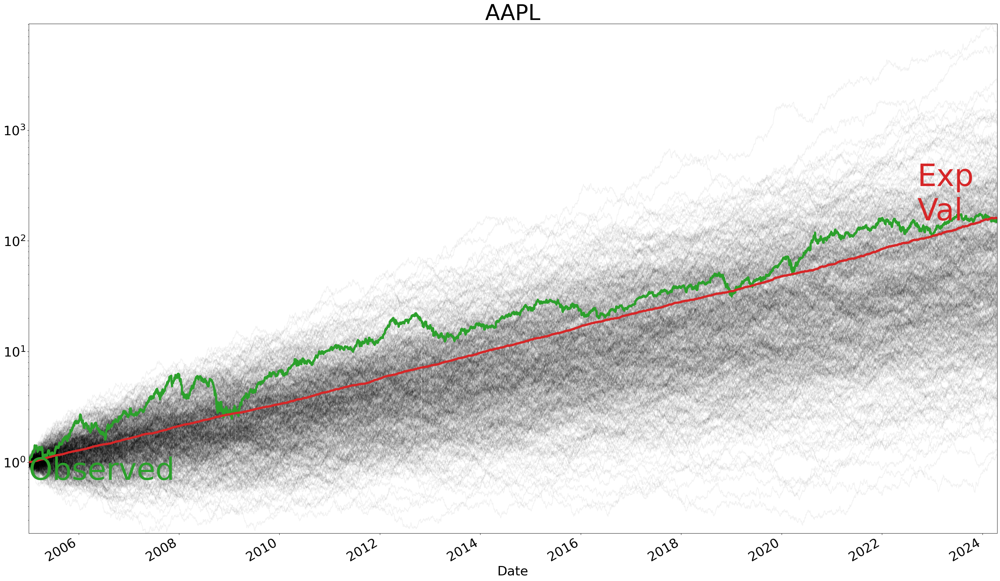

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

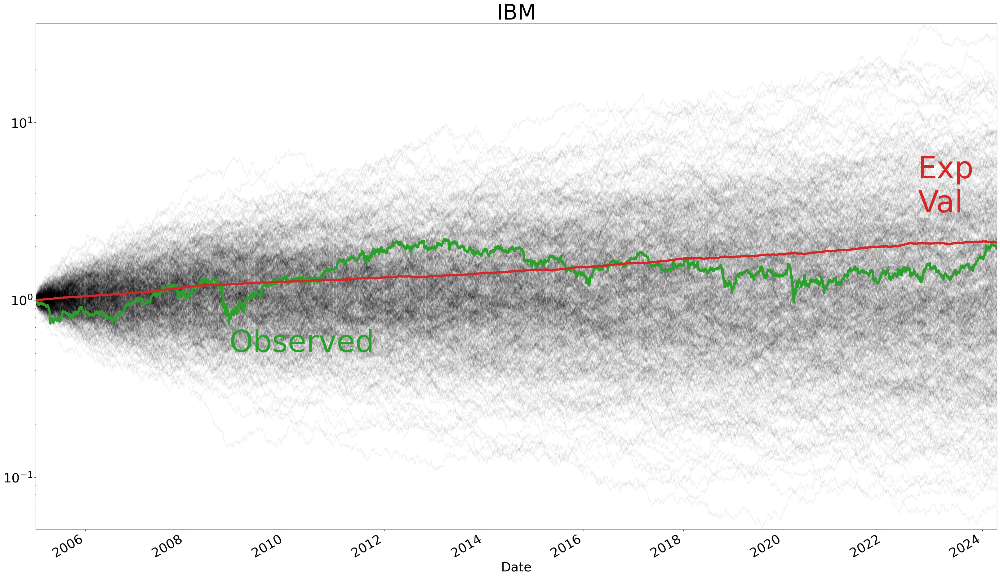

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

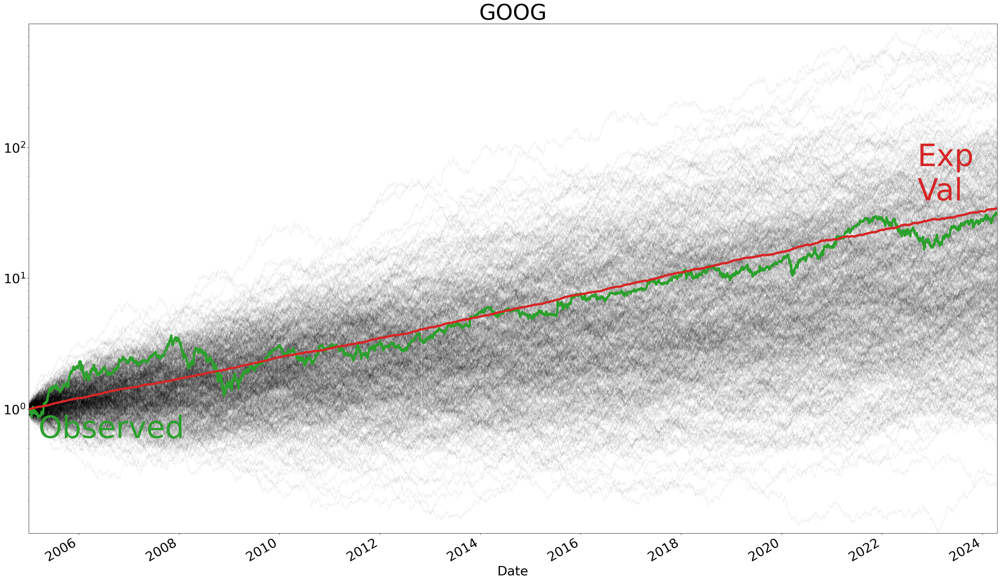

In [22]:
for stock in stocks:
    plot_monte_carlo_sim(monte_carlo_sim_dfs[stock], 
                         close_data_normalized[stock], 
                         stock, 
                         logy= True)


## Calculate Portfolio Return

In [23]:
portfolio_weights = {stock: 1 / len(stocks) for stock in stocks}
portfolio_weights

{'MSFT': 0.25, 'AAPL': 0.25, 'IBM': 0.25, 'GOOG': 0.25}

In [24]:
ex_return = pd.DataFrame(close_data_normalized.apply(lambda x :x.mul(portfolio_weights[x.name]),
                                                     axis = 0).sum(axis=1),
                                                    columns = ["Portfolio Return"])
close_data_normalized["Portfolio Return"] = ex_return
close_data_normalized

,MSFT,AAPL,IBM,GOOG,Portfolio Return
Date,,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499,0.990692
2005-01-05,1.001496,1.019118,0.987212,0.954615,0.990610
2005-01-06,1.000374,1.019908,0.984143,0.930146,0.983643
2005-01-07,0.997382,1.094169,0.979847,0.956292,1.006923
...,...,...,...,...,...
2024-04-11,16.003366,154.878109,1.989273,31.847005,51.179438
2024-04-12,15.777861,156.214189,1.950429,31.530101,51.368145
2024-04-15,15.468961,152.798800,1.939514,30.963633,50.292727


<Axes: xlabel='Date'>

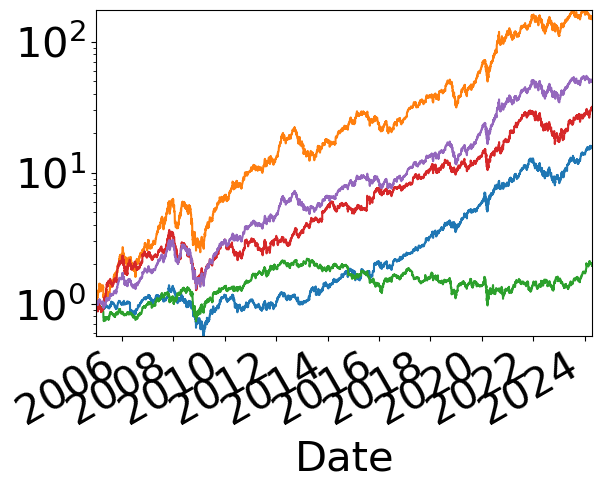

In [25]:
close_data_normalized.plot.line(legend=False, logy = True)

In [26]:
ex_return_pct_change = ex_return.pct_change()
ex_return_pct_change.dropna(inplace = True)
ex_return_pct_change

,Portfolio Return
Date,
2005-01-04,-0.009308
2005-01-05,-0.000082
2005-01-06,-0.007033
2005-01-07,0.023667
2005-01-10,0.001298
...,...
2024-04-11,0.036541
2024-04-12,0.003687
2024-04-15,-0.020936


In [27]:
mean_var_df = pd.DataFrame({"mean": (
    ex_return.iloc[-1] / ex_return.iloc[0]) **(
        1 / ex_return["Portfolio Return"].count()) -1,
                           "sigma" : ex_return_pct_change.std()})
mean_var_df

,mean,sigma
Portfolio Return,0.000803,0.016561


In [28]:
num_sims = 1000
dates = ex_return.index
monte_carlo_sim_dict = {}
mean = mean_var_df["mean"]["Portfolio Return"]
sigma = mean_var_df["sigma"]["Portfolio Return"]
run_monte_carlo(mean, 
                sigma, 
                num_sims, 
                monte_carlo_sim_dict, 
                dates)
monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).add(1).cumprod()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2005-01-03,1.012043,1.018475,1.003824,0.990283,0.995513,1.010350,1.002334,0.999179,1.014987,1.004746,...,0.976620,0.964545,1.009930,1.003619,1.014715,1.006705,0.986952,0.981589,0.993211,0.986055
2005-01-04,1.000686,0.990209,1.007353,0.984364,0.995843,0.999635,1.006336,1.029876,1.008332,1.007016,...,0.960986,0.983324,1.003051,0.993864,1.041675,1.009089,0.977157,0.967723,1.015518,0.995257
2005-01-05,0.981532,0.963393,0.976788,0.969123,0.979367,0.999802,1.021530,1.050014,1.009768,1.000678,...,0.943990,0.995593,0.997655,0.959808,1.041990,0.997177,0.965634,0.963767,1.021530,0.980956
2005-01-06,0.986501,0.985580,0.995990,0.963362,0.983100,1.002102,0.998658,1.054586,1.000679,0.993140,...,0.937448,0.998785,1.008493,0.960895,1.036378,0.992143,0.973064,0.950814,1.008470,0.954728
2005-01-07,0.958243,0.993736,0.987595,0.960989,0.989827,0.994507,0.981009,1.062787,1.009472,1.007177,...,0.932365,1.013093,1.025427,0.965405,1.016720,1.021685,0.987985,0.964055,1.020259,0.964641
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-11,113.390833,52.953492,8.658953,6.330726,120.370302,3.987807,65.301339,13.612596,14.329676,45.217680,...,20.012191,49.167126,25.761093,2.589003,8.136954,7.347636,2.686803,10.092391,64.321023,51.507369
2024-04-12,113.943501,52.911696,8.629073,6.397071,120.599481,3.937487,65.930868,13.381526,14.287720,44.406738,...,19.818656,48.700814,26.169267,2.518634,8.234813,7.345752,2.673507,10.107453,63.447236,51.152094
2024-04-15,114.290503,53.357614,8.236868,6.356477,118.757459,3.889325,64.538523,12.985796,14.204021,44.759858,...,19.163155,48.265167,26.228339,2.520488,7.985784,7.366508,2.664095,10.266138,63.386181,51.225895
2024-04-16,110.899255,54.522178,8.256956,6.359589,119.888418,3.796622,65.500049,12.948759,14.456761,44.349840,...,19.533954,47.876177,26.830984,2.524149,8.076846,7.425809,2.631679,10.411533,63.776288,50.738271


C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

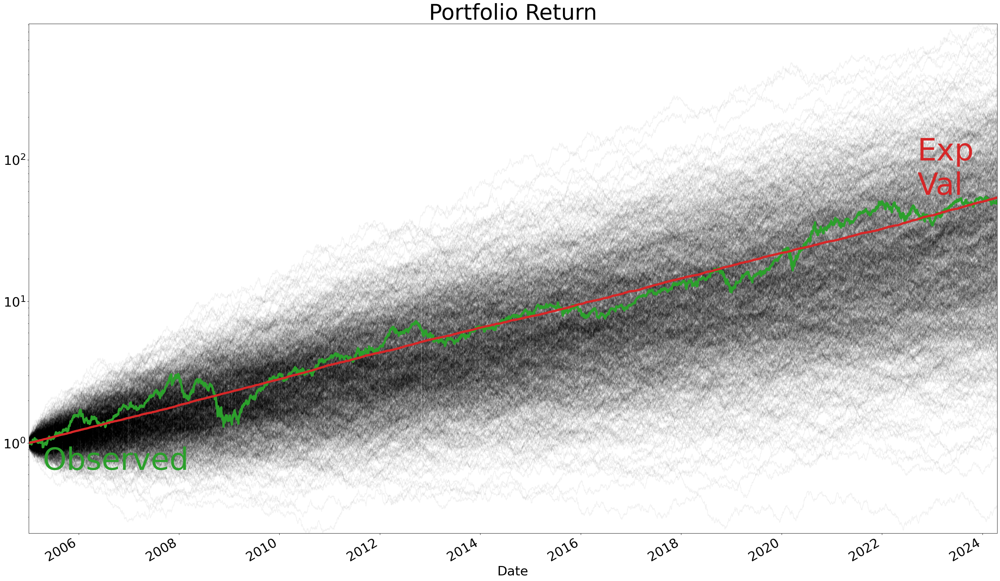

In [29]:
plot_monte_carlo_sim(monte_carlo_sim_df, 
                     ex_return["Portfolio Return"], 
                     "Portfolio Return", 
                     logy= True)